Imports

In [1]:
# required 
import os
import numpy as np
import librosa
import IPython
import IPython.display as ipd
import musdb

import spleeter
from spleeter.separator import Separator
from spleeter.audio.adapter import AudioAdapter


from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))
import mir_eval
# import sys
# if not sys.warnoptions:
#     import warnings
#     warnings.simplefilter("ignore")

In [2]:
# choose whether to plot and listen while adjusting dataset generation loop. 
# If True, data generation loop will run 5 times. If False, it will run through whole MUSDB set.
plotting = True

In [3]:
if plotting:
    from librosa import display
    from IPython import display as ipd
    import matplotlib.pyplot as plt

In [4]:
# choose whether to use tqdm
use_tqdm = True

if use_tqdm:
    from tqdm import tqdm
else:
    print("Change \"for idx, track in enumerate(tqdm(mus))\" --> \"for idx, track in enumerate(mus)\"  \n\"for idx, track in enumerate(tqdm(mus_test))\" --> \"for idx, track in enumerate(mus_test)\" \nin data generation loops")

Settings: Sample Rate and Directory Locations 

In [5]:
# set sample rate to MUSDB18 default
sr = 44100

In [6]:
# set location where you unnzipped musdb18.zip (from https://zenodo.org/record/1117372#.Yb6n1X3MJhE)
mus_dataset_root = '/Users/axelborgmo/NYU/Classes/Fall_2021/MIR/MIR-Final-Project/musdb18'

In [7]:
# set location of directory to store new dataset. [I know this is not a great location for this on my system! will change in future]
new_dataset_root = '/Users/axelborgmo/NYU/Classes/Fall_2021/MIR/MIR-Final-Project/new_dataset_root/'

# create directory if it doesn't already exist
if not os.path.isdir(new_dataset_root):
    os.mkdir(new_dataset_root)

In [8]:
if mus_dataset_root == '/Users/benschwartz/datasets/musdb18' or new_dataset_root == '/Users/benschwartz/Downloads/testnumpy1/':
    raise Exception("Change both root directories above")

Create or Set Directories for Storing New Dataset

In [9]:
# create directories for new dataset (subset: training) if they don't already exist 
est_specs_stored = new_dataset_root + 'est'
target_specs_stored = new_dataset_root + 'target'
phase_stored = new_dataset_root + 'phase'



if not os.path.isdir(est_specs_stored):
    os.mkdir(est_specs_stored) 
if not os.path.isdir(target_specs_stored):
    os.mkdir(target_specs_stored)
if not os.path.isdir(phase_stored):
    os.mkdir(phase_stored)

In [10]:
os.listdir(new_dataset_root)

['test_target',
 'phase',
 '.DS_Store',
 'test_phase',
 'target',
 'test_est',
 'est']

In [11]:
# create directories for new dataset (subset: test) if they don't already exist 
test_est_specs_stored = new_dataset_root + 'test_est'
test_target_specs_stored = new_dataset_root + 'test_target'
test_phase_stored = new_dataset_root + 'test_phase'

if not os.path.isdir(test_est_specs_stored):
    os.mkdir(test_est_specs_stored)
if not os.path.isdir(test_target_specs_stored):
    os.mkdir(test_target_specs_stored)
if not os.path.isdir(test_phase_stored):
    os.mkdir(test_phase_stored)

Generate New Dataset of Ground Truth Stems from MUSDB18 and Spleeter-Seperated Estimates 

In [12]:
# create handles for MUS training and test sets
mus = musdb.DB(download=True, root=mus_dataset_root, subsets="train")
mus_test = musdb.DB(download=True, root=mus_dataset_root, subsets="test")

In [13]:
testaudio= mus[0].targets['bass'].audio.T
ipd.Audio(testaudio, rate=sr)

In [14]:
# instantiate Spleeter model and Spleeter's audio loader 
separator = Separator('spleeter:4stems')
audio_loader = AudioAdapter.default()

In [15]:
# create dictionaries for plotting and listening, if necessary
if plotting:
    est_dict, tru_dict = {}, {}
    audio_est_dict, audio_tru_dict = {}, {}

In [16]:
# loop through MUSDB18 training subset, generating new dataset
for idx, track in enumerate(tqdm(mus)):
#     set sample starting point and duration in seconds
    track.chunk_start = 10.0
    track.chunk_duration = 10.0
    
#     get mixture phase
    mix_stft = librosa.stft(np.mean(track.audio.T, axis=0))
    mix_phase = np.angle(mix_stft)
    
#     get ground truth and convert to mono 
    truth = np.mean(track.targets['bass'].audio.T, axis=0)
    
#     get ground truth magnitudes 
    true_stft = librosa.stft(truth)                        
    true_spec = np.abs(true_stft)
    
#     get estimate and convert to mono 
    waveform, _ = audio_loader.load(track.path, sample_rate=sr, duration=10.0, offset=10.0)
    estimate = np.mean(separator.separate(waveform)['bass'].T, axis=0)
    
#     get estimated magnitudes    
    est_stft= librosa.stft(estimate)
    est_spec = np.abs(est_stft)
    
#     save everything
    np.save(os.path.join(est_specs_stored, str(idx)), np.asarray(est_spec))
    np.save(os.path.join(target_specs_stored, str(idx)), np.asarray(true_spec))
    np.save(os.path.join(phase_stored, str(idx)), np.asarray(mix_phase))

#     store in dictionaries if plotting and listening for debugging purposes
    if plotting: 
        est_dict[str(idx)] = est_spec 
        tru_dict[str(idx)] = true_spec
        audio_est_dict[str(idx)] = estimate
        audio_tru_dict[str(idx)] = truth
        
        if idx>3:
            break

  0%|          | 0/100 [00:00<?, ?it/s]

INFO:tensorflow:Apply unet for vocals_spectrogram
Instructions for updating:
Colocations handled automatically by placer.
INFO:tensorflow:Apply unet for drums_spectrogram
INFO:tensorflow:Apply unet for bass_spectrogram
INFO:tensorflow:Apply unet for other_spectrogram
INFO:tensorflow:Restoring parameters from pretrained_models/4stems/model


  4%|▍         | 4/100 [00:13<05:13,  3.26s/it]


In [17]:
# loop through MUSDB18 test subset, generating new dataset (same process as above, without plotting option)
for idx, track in (enumerate(tqdm(mus_test))):
    track.chunk_duration = 10.0
    track.chunk_start = 50.0
    
#     get mixture phase
    mix_stft = librosa.stft(np.mean(track.audio.T, axis=0))
    mix_phase = np.angle(mix_stft)
    
#     get ground truth and convert to mono 
    truth = np.mean(track.targets['bass'].audio.T, axis=0)
    
#     get ground truth magnitudes 
    true_stft = librosa.stft(truth)                        
    true_spec = np.abs(true_stft)
    
#     get estimate and convert to mono 
    waveform, _ = audio_loader.load(track.path, sample_rate=sr, duration=10.0, offset=50.0)
    estimate = np.mean(separator.separate(waveform)['bass'].T, axis=0)
    
#     get estimated magnitudes    
    est_stft= librosa.stft(estimate)
    est_spec = np.abs(est_stft)
    
#     save everything
    np.save(os.path.join(test_est_specs_stored, str(idx)), np.asarray(est_spec))
    np.save(os.path.join(test_target_specs_stored, str(idx)), np.asarray(true_spec))
    np.save(os.path.join(test_phase_stored, str(idx)), np.asarray(mix_phase))

100%|██████████| 50/50 [01:31<00:00,  1.83s/it]


Plotting and Listening

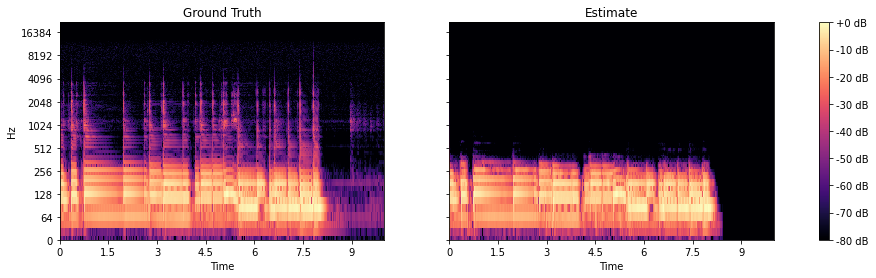

Real Audio:


Estimated Audio:


In [18]:
# compare ground-truth stems to Spleeter-seperated estimates 

sample_num = 0

if plotting:
#     set sample number between 0 and 4
    
    est = est_dict[str(sample_num)]
    tru = tru_dict[str(sample_num)]
    
#     plot them
    fig, ax = plt.subplots(nrows=1, ncols=2, sharey=True)
    
#     estimate
    D = librosa.amplitude_to_db(np.abs(est), ref=np.max)
    img = librosa.display.specshow(D, y_axis='log', x_axis='time', sr=sr, ax=ax[1])
    ax[1].set(title='Estimate')
    ax[1].label_outer()
    
#     ground truth
    D = librosa.amplitude_to_db(np.abs(tru),ref=np.max)
    librosa.display.specshow(D, y_axis='log', sr=sr, x_axis='time', ax=ax[0])
    ax[0].set(title='Ground Truth')
    ax[0].label_outer()

    fig.colorbar(img, ax=ax, format="%+2.f dB")
    fig.set_figwidth(16)
    
    plt.show()

    # play them     
    truth = audio_tru_dict[str(sample_num)]
    estimate = audio_est_dict[str(sample_num)] 

    a1 = ipd.Audio(truth,rate=sr)
    a2 = ipd.Audio(estimate,rate=sr)

    print("Real Audio:")
    ipd.display(a1)
    print("Estimated Audio:")
    ipd.display(a2)